In [1]:
import numpy as np
import matplotlib.image as mpimg
import matplotlib.pyplot as plt 
import os
import cv2
import glob

In [2]:
def initBackground(init_image):
    mean = mpimg.imread(init_image)
    variance = 9*np.ones(mean.shape)
    return(mean,variance)

In [26]:
def ForegroundDetection(image,mean,variance,lmda):
    d = image - mean
    y = variance*(lmda**2)  
    d_2 = np.square(d)
    I = d_2 - y
    mask = np.all(I>0,axis=2)  # Chebychev inequality check
    r_image = 255*mask.astype(int)
    r_image = r_image.astype(np.uint8)
    return(r_image)

In [22]:
def cleaning(rI, cI):
#     print(rI.dtype)
    rI = rI-cI
    kernel = np.ones((5, 5), np.uint8)
    erosion_img = cv2.erode(rI, kernel, 10)
    dilation_img = cv2.dilate(erosion_img, kernel, 1)
#     cv2.imshow('clean', dilation_img)
#     if cv2.waitKey(0) & 0xFF == ord('q'):
#         cv2.destroyAllWindows()
#         return dilation_img
    return dilation_img

In [5]:
def meanvarUpdate(c_image,image,M,V,alpha):
    mean_upd = np.zeros(image.shape)
    var_upd = np.zeros(image.shape)
    d = image - M
    d_2 = np.square(d)
    for i in range(c_image.shape[0]):
        for j in range(c_image.shape[1]):
            if c_image[i,j] == 0:
                mean_upd[i,j,:] = (1-alpha)*M[i,j,:] + alpha*image[i,j,:]
                var_upd[i,j,:] = (1-alpha)*(V[i,j,:] + alpha*d_2[i,j,:])
                var_upd[i,j,:] = np.clip(var_upd[i,j,:],a_min = 9,a_max = None)
    return(mean_upd,var_upd)

In [37]:
def Background_Subtraction(lmda,eta,m,n,alpha):
    
    image_list = glob.glob('video_frames/frame*.jpg')
    image_list.sort()
    mean, variance = initBackground(image_list[30])
    mean_var_dict = {}
    c_image = np.zeros((mean.shape[0], mean.shape[1]))
    for i in range(31,len(image_list)):
#     for i in range(31,32):
        image_path = image_list[i]
        image = cv2.imread(image_path)
        
        fig, ax = plt.subplots(1,3,figsize=(15,15))
        
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        r_image = ForegroundDetection(image,mean,variance,lmda)
#         if i == 31:
#             c_image = Voting(r_image,eta,m,n)
#         else:
        c_image = cleaning(r_image, c_image)
        mean, variance = meanvarUpdate(c_image,image,mean,variance,alpha)
        
        mean_var_dict[i] = [mean, variance]
        ax[0].imshow(image,cmap="gray")
        ax[1].imshow(r_image,cmap="gray")
        ax[2].imshow(c_image,cmap="gray")
        plt.show()
#     print(mean_var_dict)

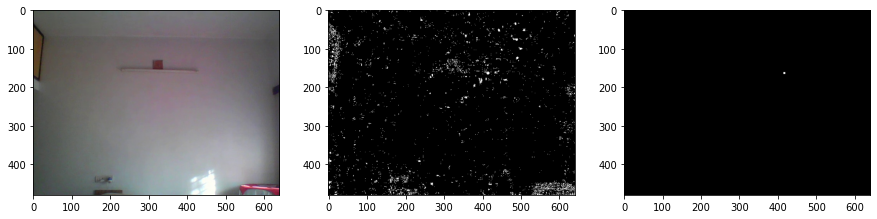

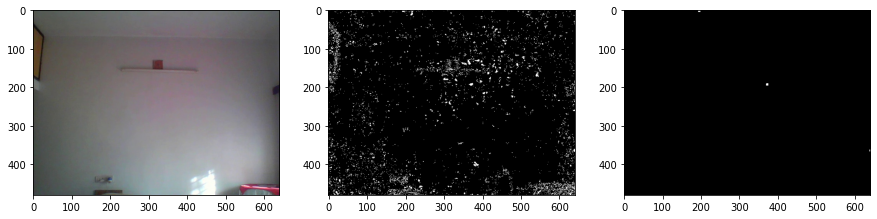

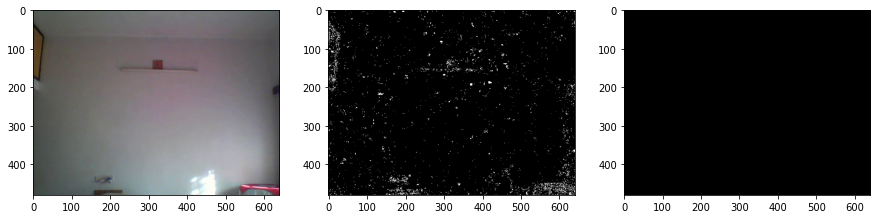

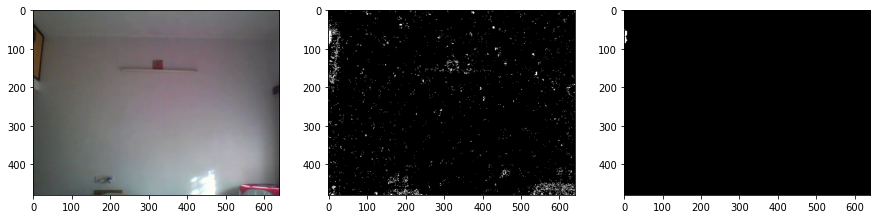

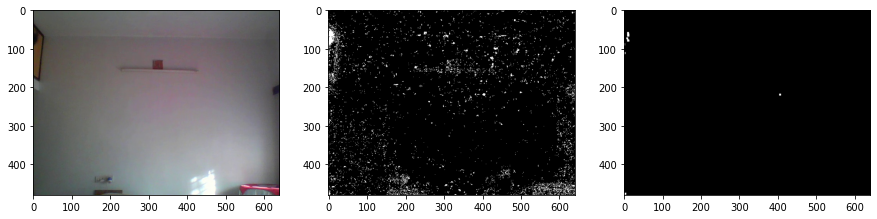

...

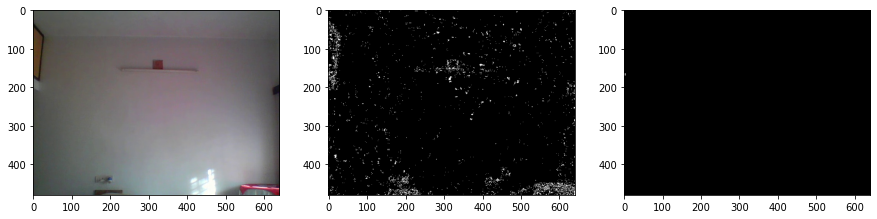

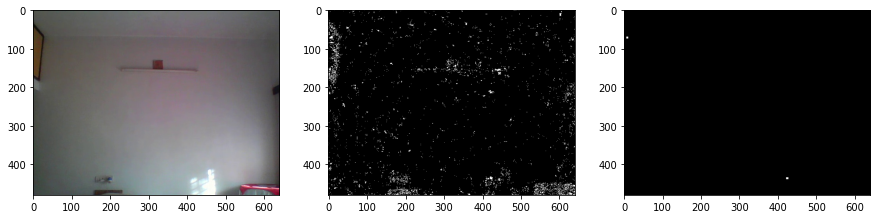

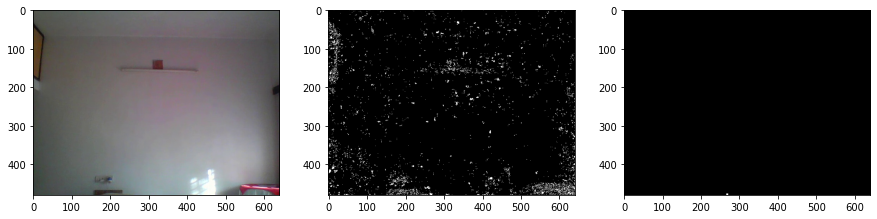

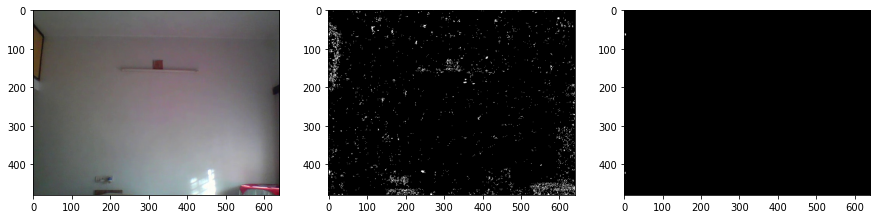

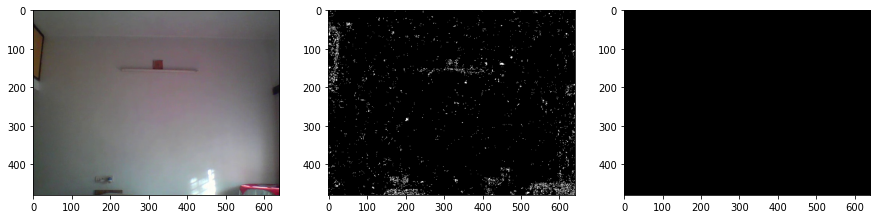

In [38]:
Background_Subtraction(0.8,0.7,7,7,0.8)